In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img,array_to_img
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

In [3]:
BASE_DIR='/kaggle/input/landscape-pictures'

In [4]:
#Removing Image paths
image_paths=[]
for image_name in os.listdir(BASE_DIR):
    image_path=os.path.join(BASE_DIR,image_name)
    image_paths.append(image_path)

In [5]:
len(image_paths)

4319

In [7]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array

IMAGE_SIZE = (64, 64)  # Set a fixed size

train_images = []
for path in tqdm(image_paths):
    img = load_img(path, target_size=IMAGE_SIZE)  # Resize images
    img = img_to_array(img)  # Convert to NumPy array
    train_images.append(img)



  0%|          | 0/4319 [00:00<?, ?it/s]

In [8]:
train_images[0].shape

(64, 64, 3)

In [10]:

train_images = np.array(train_images)
train_images=(train_images-127.5)/127.5
#normalisation

In [11]:
train_images[0]

array([[[ 0.5137255 ,  0.6784314 ,  0.92156863],
        [ 0.67058825,  0.8039216 ,  0.94509804],
        [ 0.8352941 ,  0.9372549 ,  1.        ],
        ...,
        [-0.44313726, -0.05098039,  0.69411767],
        [-0.43529412, -0.05098039,  0.69411767],
        [-0.46666667, -0.05098039,  0.6862745 ]],

       [[ 0.6       ,  0.7411765 ,  0.8980392 ],
        [ 0.69411767,  0.8117647 ,  0.9607843 ],
        [ 0.827451  ,  0.92941177,  0.9764706 ],
        ...,
        [-0.46666667, -0.07450981,  0.60784316],
        [-0.43529412, -0.02745098,  0.7490196 ],
        [-0.44313726, -0.02745098,  0.7254902 ]],

       [[ 0.58431375,  0.7176471 ,  0.92156863],
        [ 0.73333335,  0.8352941 ,  0.9607843 ],
        [ 0.67058825,  0.8039216 ,  0.94509804],
        ...,
        [-0.39607844,  0.01960784,  0.7411765 ],
        [-0.4117647 ,  0.00392157,  0.75686276],
        [-0.41960785,  0.00392157,  0.77254903]],

       ...,

       [[ 0.20784314,  0.02745098, -0.11372549],
        [ 0

In [12]:
#generator
LATENT_DIM=100#latent dimension for random noise
WEIGHT_INIT=keras.initializers.RandomNormal(mean=0.0,stddev=0.02)
#no.of channels
CHANNELS=3


In [13]:
#generator model creates new image from training data from noise
model=Sequential(name="generator")
model.add(layers.Dense(8*8*512,input_dim=LATENT_DIM))#creating noise which is 1d
model.add(layers.BatchNormalization())#comment batchnormalisation
model.add(layers.ReLU())

model.add(layers.Reshape((8,8,512)))#1d to 3d

#upsmple to 16*16
model.add(layers.Conv2DTranspose(256,(4,4),strides=(2,2),padding="same",kernel_initializer=WEIGHT_INIT))
model.add(layers.BatchNormalization())
model.add(layers.ReLU())

#upsmple to 32*32
model.add(layers.Conv2DTranspose(128,(4,4),strides=(2,2),padding="same",kernel_initializer=WEIGHT_INIT))
model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2DTranspose(64,(4,4),strides=(2,2),padding="same",kernel_initializer=WEIGHT_INIT))
model.add(layers.BatchNormalization())
model.add(layers.ReLU())


model.add(layers.Conv2D(CHANNELS,(4,4),padding="same",activation="tanh"))

generator=model
generator.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 32768)               │       3,309,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 32768)               │         131,072 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu (ReLU)                         │ (None, 32768)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 16, 16, 256)         │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 16, 16, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_1 (ReLU)                       │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 32, 32, 128)         │         524,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 32, 32, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_2 (ReLU)                       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 64, 64, 64)          │         131,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 64, 64, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_3 (ReLU)                       │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 64, 64, 3)           │           3,075 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,198,467 (23.65 MB)

 Trainable params: 6,132,035 (23.39 MB)

 Non-trainable params: 66,432 (259.50 KB)

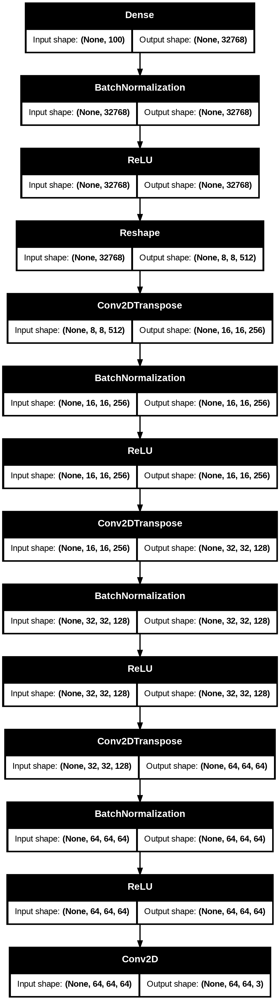

In [14]:
from tensorflow.keras.utils import plot_model

plot_model(generator,show_shapes=True)

In [15]:
#discriminator checks if real or fake
#we train the generator model until we have fooled the discriminator
model=Sequential(name="discriminator")
input_shape=(64,64,3)
alpha=0.2

model.add(layers.Conv2D(64,(4,4),strides=(2,2),padding="same",input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128,(4,4),strides=(2,2),padding="same",input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128,(4,4),strides=(2,2),padding="same",input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

model.add(layers.Dense(1,activation="sigmoid"))

discriminator=model
discriminator.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.10/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_1 (Conv2D)                    │ (None, 32, 32, 64)          │           3,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 32, 32, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 16, 16, 128)         │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_5                │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 8, 8, 128)           │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_6                │ (None, 8, 8, 128)           │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 8, 8, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │           8,193 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

In [29]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn  # ✅ Assigning loss function properly

    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # Train Discriminator
        with tf.GradientTape() as tape:
            pred_real = self.discriminator(real_images, training=True)
            real_labels = tf.ones((batch_size, 1))
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)

            fake_images = self.generator(random_noise, training=True)
            pred_fake = self.discriminator(fake_images, training=True)

            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            d_loss = (d_loss_real + d_loss_fake) / 2

        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)  # ✅ Fixed typo
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))

        # Train Generator
        labels = tf.ones((batch_size, 1))
        with tf.GradientTape() as tape:
            fake_images = self.generator(random_noise, training=True)
            pred_fake = self.discriminator(fake_images, training=True)
            g_loss = self.loss_fn(labels, pred_fake)

        gradients = tape.gradient(g_loss, self.generator.trainable_variables)  # ✅ Fixed typo
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))  # ✅ Used correct variables

        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}


            
            



In [38]:
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow import keras

class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        self.noise = tf.random.normal([self.num_imgs, latent_dim])  # Noise for generating images

    def on_epoch_end(self, epoch, logs=None):
        g_img = self.model.generator(self.noise, training=False)  # Ensure inference mode
        g_img = (g_img + 1) * 127.5  # ✅ Corrected normalization
        g_img = tf.clip_by_value(g_img, 0, 255)  # Avoid overflow
        g_img = g_img.numpy().astype("uint8")  # ✅ Convert to NumPy array
        
        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i + 1)
            plt.imshow(g_img[i])  # ✅ Directly display NumPy image
            plt.axis("off")

        plt.show()

    def on_train_end(self, logs=None):
        self.model.generator.save("generator.h5")  # ✅ Save trained generator model


In [39]:
dcgan=DCGAN(generator=generator,discriminator=discriminator,latent_dim=LATENT_DIM)

In [40]:
D_LR=0.0001
G_LR=0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR,beta_1=0.5),d_optimizer=Adam(learning_rate=D_LR,beta_1=0.5),loss_fn=BinaryCrossentropy())


Epoch 1/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.9087 - g_loss: 0.6643

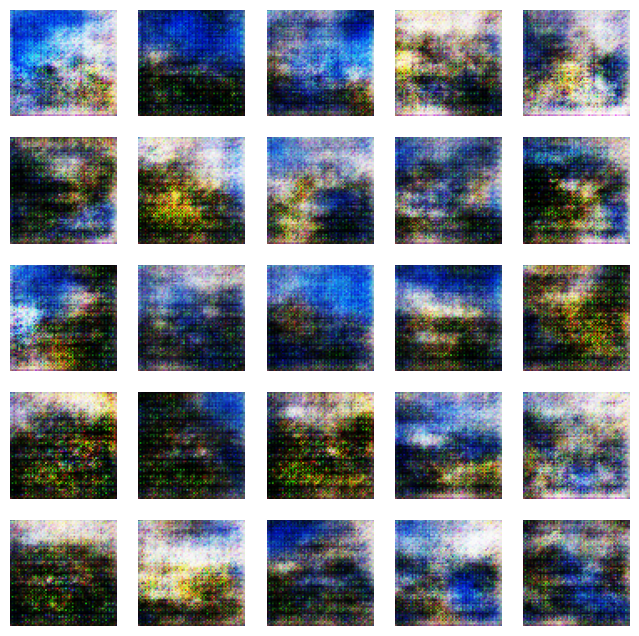

135/135 ━━━━━━━━━━━━━━━━━━━━ 315s 2s/step - d_loss: 0.9084 - g_loss: 0.6643
Epoch 2/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.8092 - g_loss: 0.6785

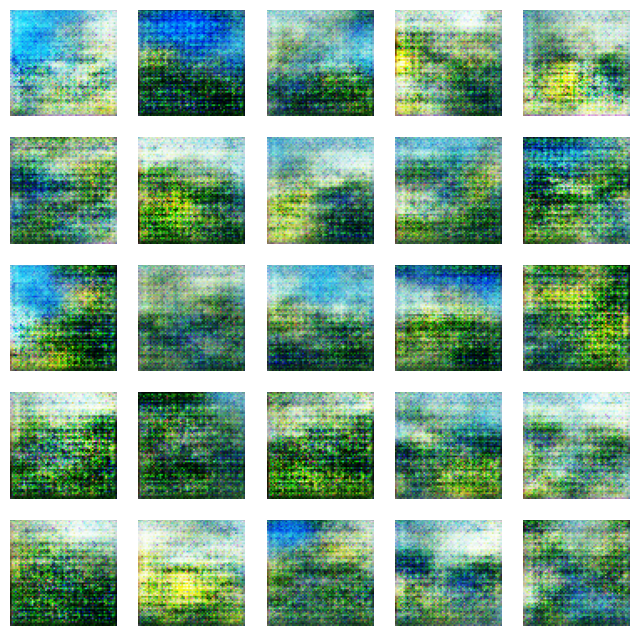

135/135 ━━━━━━━━━━━━━━━━━━━━ 306s 2s/step - d_loss: 0.8091 - g_loss: 0.6785
Epoch 3/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7759 - g_loss: 0.6744

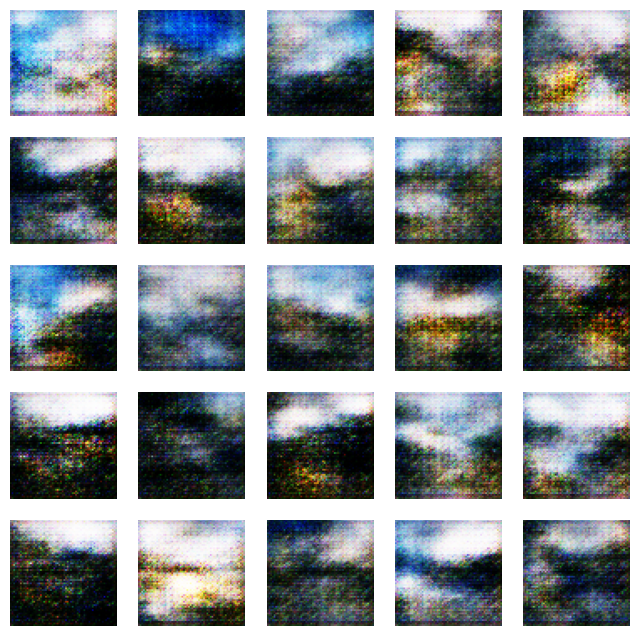

135/135 ━━━━━━━━━━━━━━━━━━━━ 306s 2s/step - d_loss: 0.7759 - g_loss: 0.6745
Epoch 4/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7538 - g_loss: 0.6879

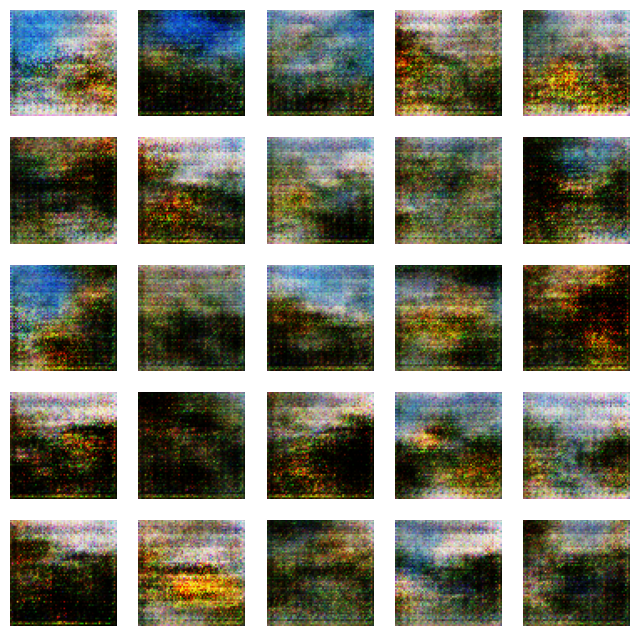

135/135 ━━━━━━━━━━━━━━━━━━━━ 311s 2s/step - d_loss: 0.7538 - g_loss: 0.6879
Epoch 5/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7547 - g_loss: 0.6930

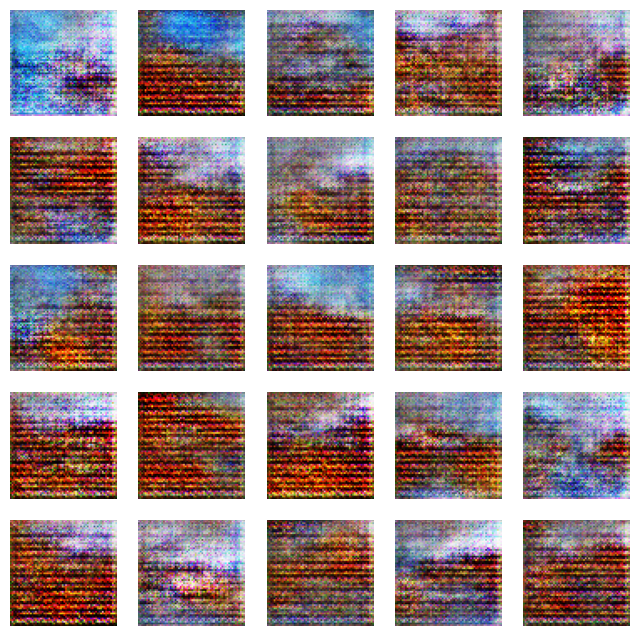

135/135 ━━━━━━━━━━━━━━━━━━━━ 309s 2s/step - d_loss: 0.7547 - g_loss: 0.6930
Epoch 6/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7444 - g_loss: 0.7203

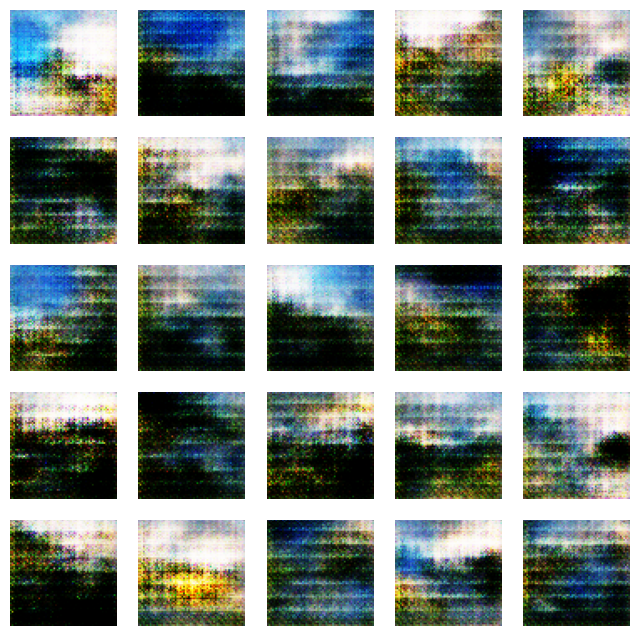

135/135 ━━━━━━━━━━━━━━━━━━━━ 308s 2s/step - d_loss: 0.7444 - g_loss: 0.7202
Epoch 7/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7407 - g_loss: 0.6983

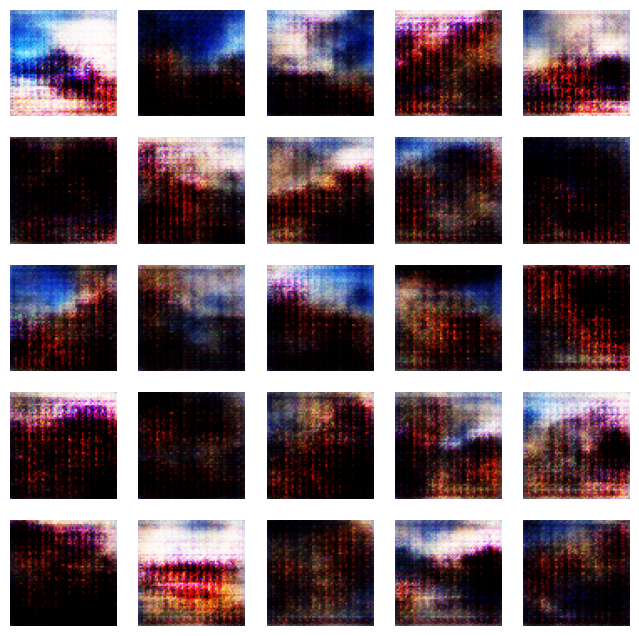

135/135 ━━━━━━━━━━━━━━━━━━━━ 320s 2s/step - d_loss: 0.7406 - g_loss: 0.6983
Epoch 8/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7313 - g_loss: 0.6970

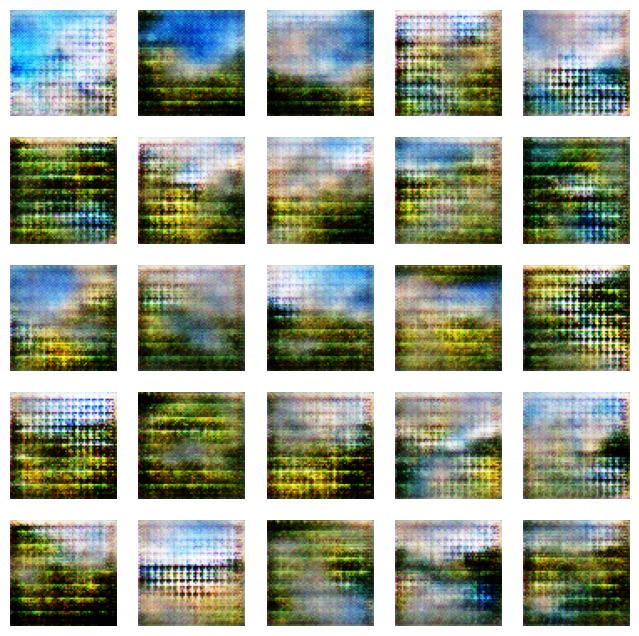

135/135 ━━━━━━━━━━━━━━━━━━━━ 305s 2s/step - d_loss: 0.7313 - g_loss: 0.6970
Epoch 9/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7305 - g_loss: 0.7076

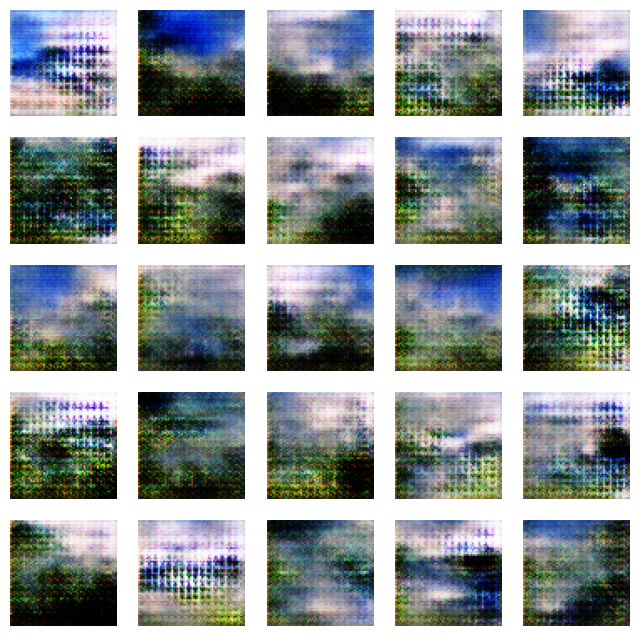

135/135 ━━━━━━━━━━━━━━━━━━━━ 303s 2s/step - d_loss: 0.7305 - g_loss: 0.7076
Epoch 10/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7293 - g_loss: 0.7206

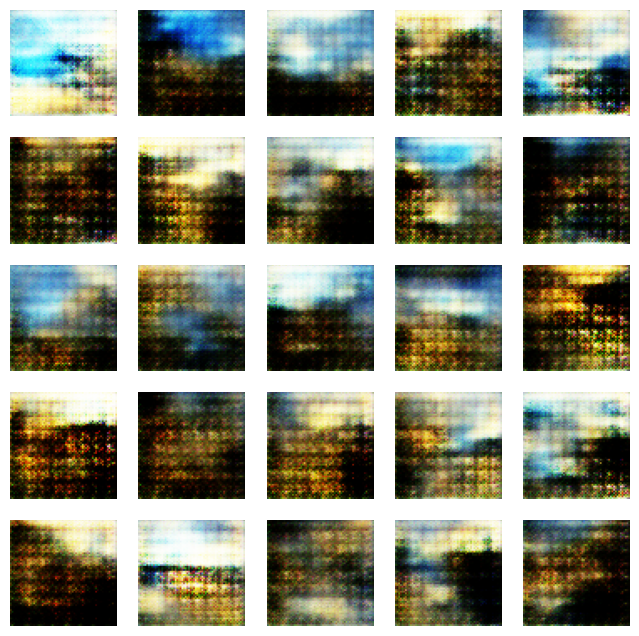

135/135 ━━━━━━━━━━━━━━━━━━━━ 304s 2s/step - d_loss: 0.7293 - g_loss: 0.7205
Epoch 11/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7208 - g_loss: 0.7006

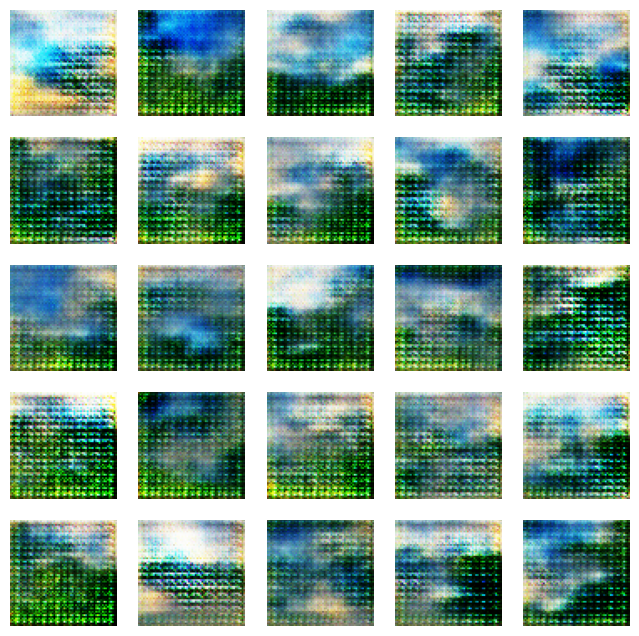

135/135 ━━━━━━━━━━━━━━━━━━━━ 307s 2s/step - d_loss: 0.7209 - g_loss: 0.7006
Epoch 12/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7221 - g_loss: 0.6928

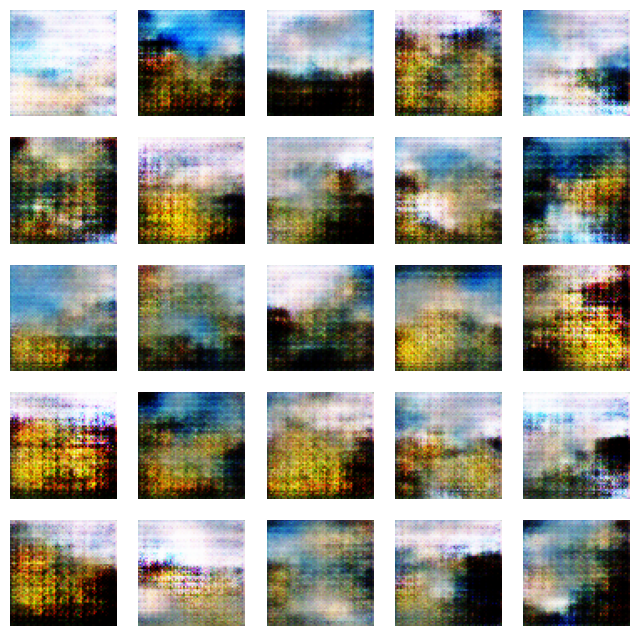

135/135 ━━━━━━━━━━━━━━━━━━━━ 309s 2s/step - d_loss: 0.7221 - g_loss: 0.6928
Epoch 13/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7234 - g_loss: 0.7004

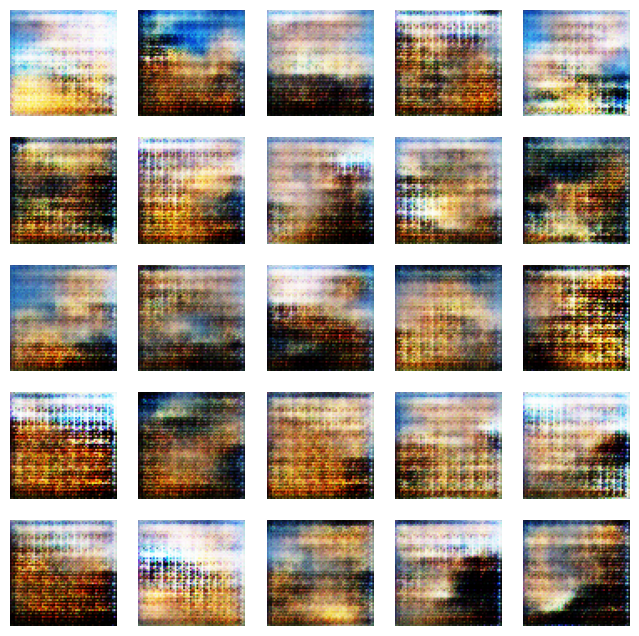

135/135 ━━━━━━━━━━━━━━━━━━━━ 305s 2s/step - d_loss: 0.7234 - g_loss: 0.7004
Epoch 14/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7128 - g_loss: 0.7021

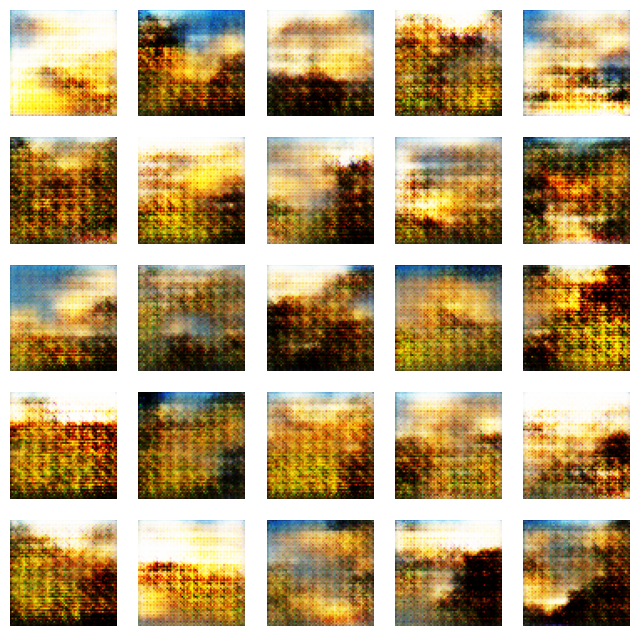

135/135 ━━━━━━━━━━━━━━━━━━━━ 304s 2s/step - d_loss: 0.7128 - g_loss: 0.7022
Epoch 15/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7164 - g_loss: 0.6948

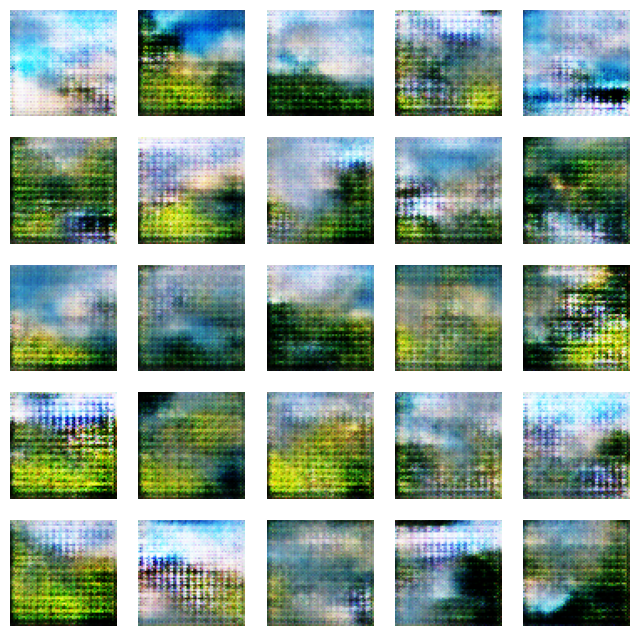

135/135 ━━━━━━━━━━━━━━━━━━━━ 306s 2s/step - d_loss: 0.7164 - g_loss: 0.6947
Epoch 16/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7202 - g_loss: 0.6830

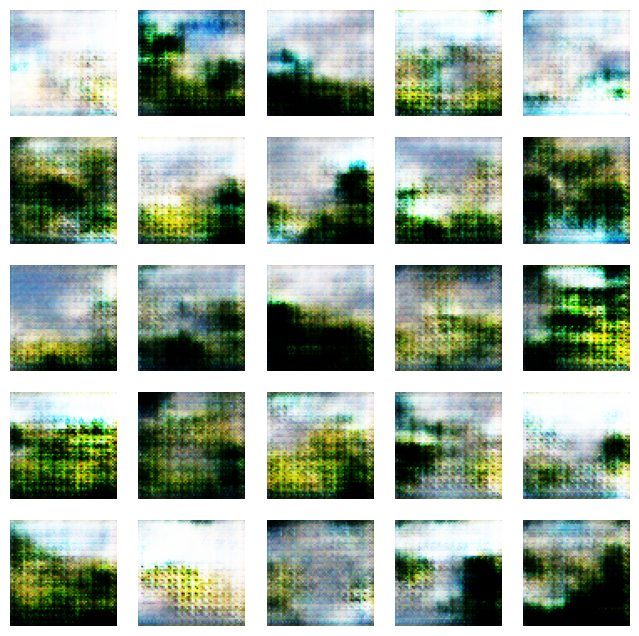

135/135 ━━━━━━━━━━━━━━━━━━━━ 306s 2s/step - d_loss: 0.7202 - g_loss: 0.6831
Epoch 17/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7132 - g_loss: 0.7054

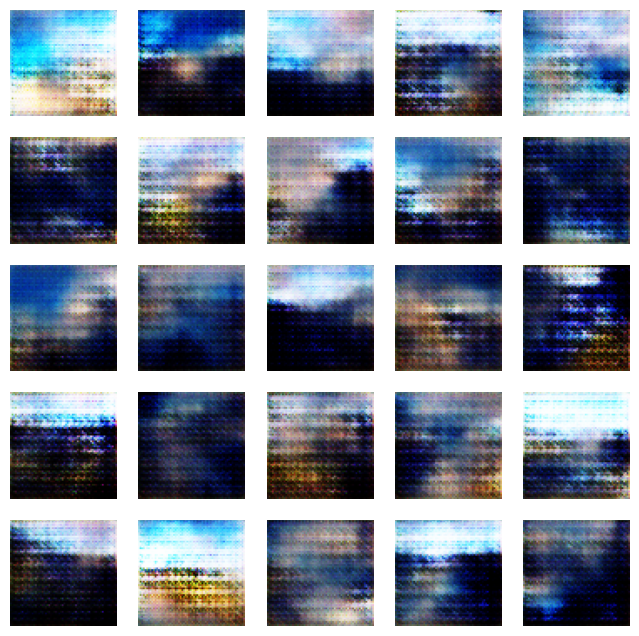

135/135 ━━━━━━━━━━━━━━━━━━━━ 305s 2s/step - d_loss: 0.7132 - g_loss: 0.7054
Epoch 18/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7165 - g_loss: 0.6924

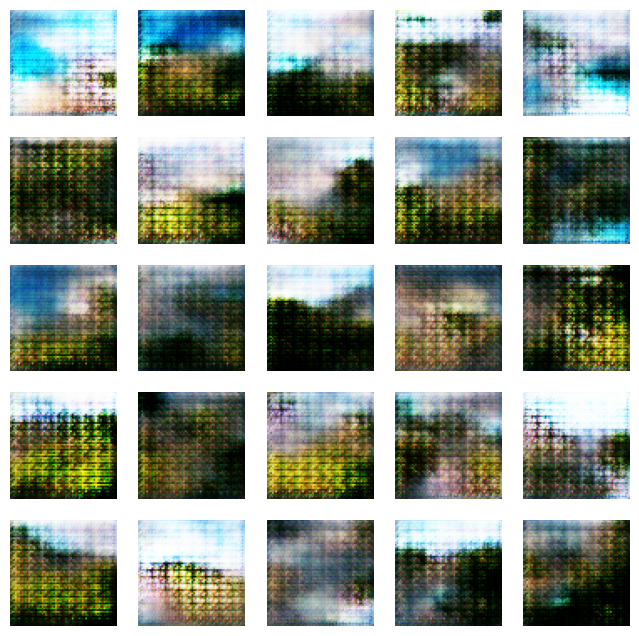

135/135 ━━━━━━━━━━━━━━━━━━━━ 305s 2s/step - d_loss: 0.7165 - g_loss: 0.6924
Epoch 19/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7159 - g_loss: 0.6912

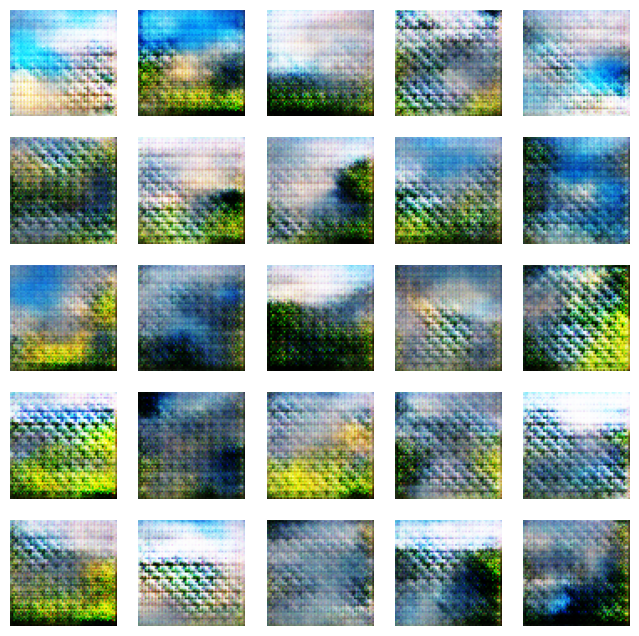

135/135 ━━━━━━━━━━━━━━━━━━━━ 305s 2s/step - d_loss: 0.7159 - g_loss: 0.6913
Epoch 20/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7163 - g_loss: 0.6842

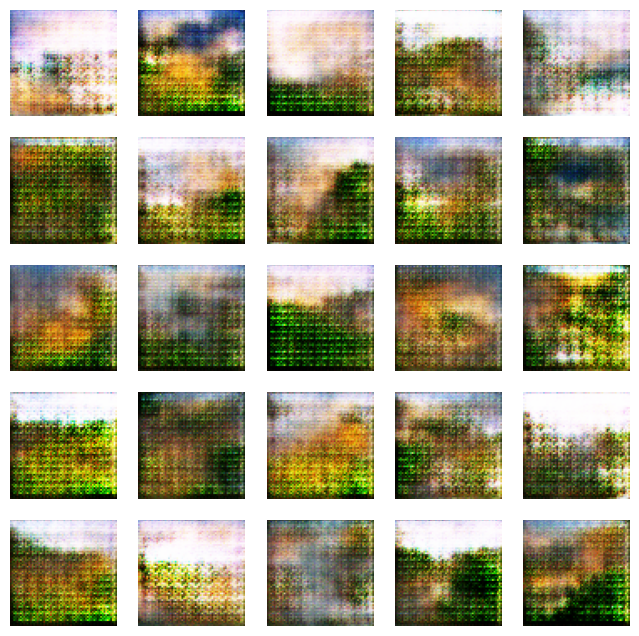

135/135 ━━━━━━━━━━━━━━━━━━━━ 305s 2s/step - d_loss: 0.7163 - g_loss: 0.6842
Epoch 21/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7107 - g_loss: 0.7175

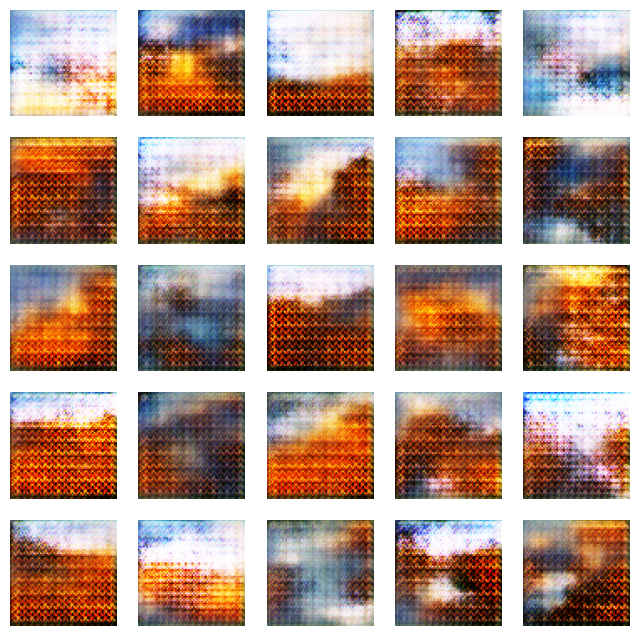

135/135 ━━━━━━━━━━━━━━━━━━━━ 310s 2s/step - d_loss: 0.7107 - g_loss: 0.7174
Epoch 22/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7133 - g_loss: 0.6990

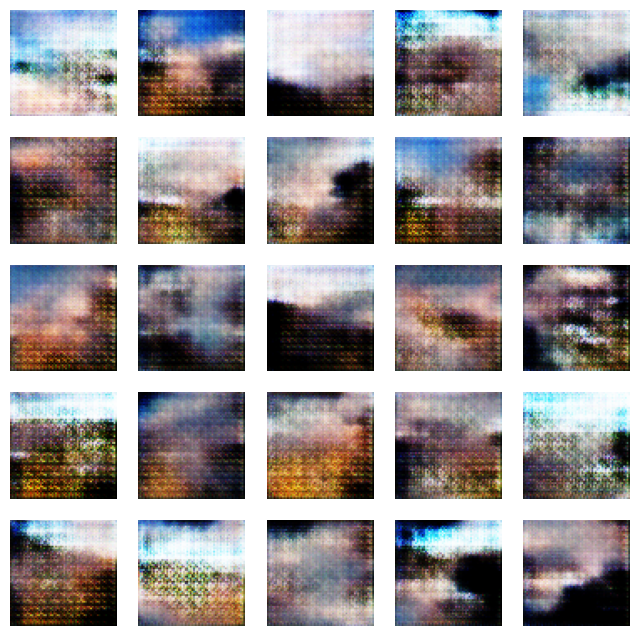

135/135 ━━━━━━━━━━━━━━━━━━━━ 311s 2s/step - d_loss: 0.7133 - g_loss: 0.6990
Epoch 23/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7111 - g_loss: 0.6957

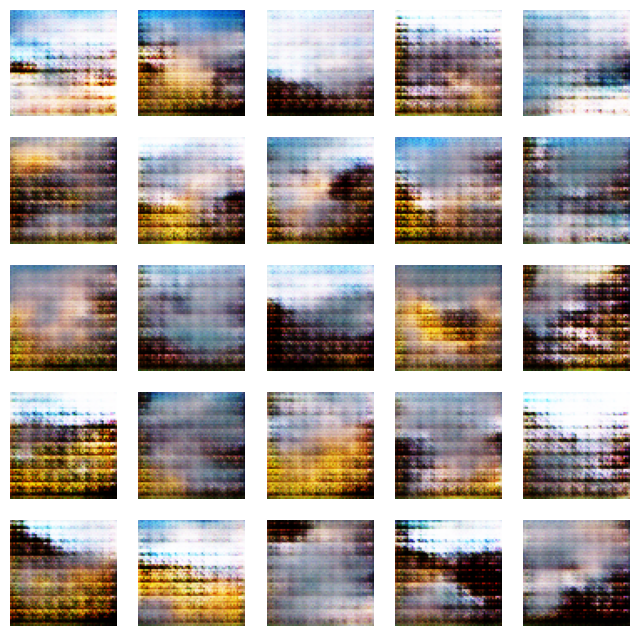

135/135 ━━━━━━━━━━━━━━━━━━━━ 307s 2s/step - d_loss: 0.7111 - g_loss: 0.6956
Epoch 24/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7133 - g_loss: 0.6898

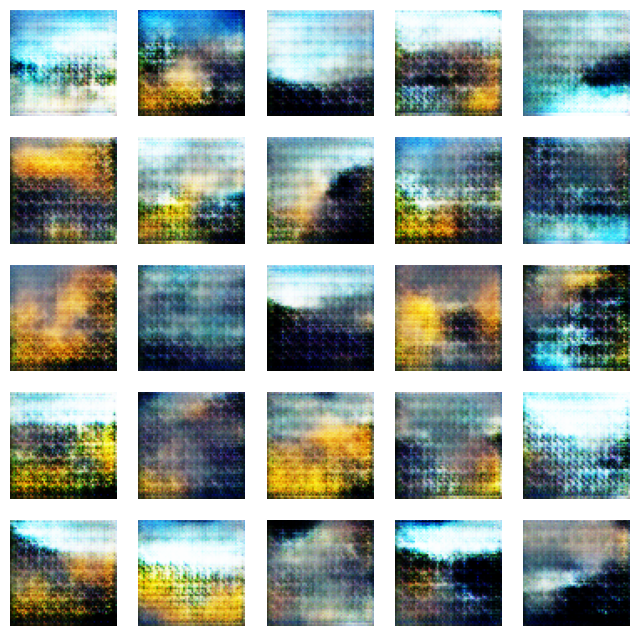

135/135 ━━━━━━━━━━━━━━━━━━━━ 306s 2s/step - d_loss: 0.7133 - g_loss: 0.6898
Epoch 25/50
135/135 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.7116 - g_loss: 0.6798

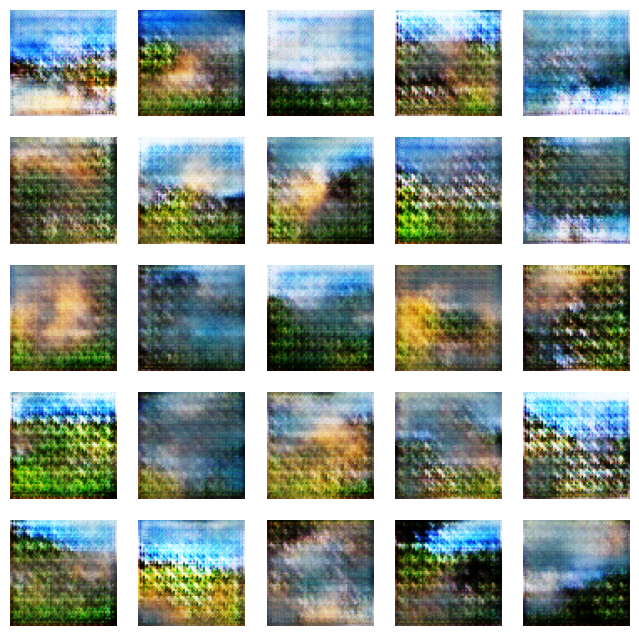

135/135 ━━━━━━━━━━━━━━━━━━━━ 303s 2s/step - d_loss: 0.7116 - g_loss: 0.6798
Epoch 26/50
 52/135 ━━━━━━━━━━━━━━━━━━━━ 3:07 2s/step - d_loss: 0.7098 - g_loss: 0.7042

KeyboardInterrupt: 

In [41]:
N_EPOCHS=50
dcgan.fit(train_images,epochs=N_EPOCHS,callbacks=[DCGANMonitor()])